In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import datetime
import os
import urllib
from zipfile import ZipFile
DOWNLOAD_FOLDER = "dataset"
LINE_DATA_FOLDER = "line_data"

In [7]:
%load_ext autoreload
%autoreload 2

from get_data import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [8]:
# Define rectangle boundaries
x_min, x_max = 2531838.30, 2533571.35
y_min, y_max = 1152042.99, 1153095.62

# Download didok data
didok_url = "https://opentransportdata.swiss/fr/dataset/service-points-full/permalink"
didok_file, date = download_cache(didok_url, "DIDOK_{date}.csv", zip=True)

stops_df = pd.read_csv(didok_file, delimiter= ";")

# Download timetable data:
timetable_url = "https://opentransportdata.swiss/fr/dataset/istdaten/resource_permalink/{date}_istdaten.csv"
timetable_file, date= download_cache(timetable_url, "Timetable_{date}.csv", date)
timetable_df = pd.read_csv(timetable_file, delimiter= ";")

# Filter stops
# ------------

# Only keep interesting columns
stops_df = stops_df[['lv95East', 'lv95North', 'validFrom', 'validTo', 'number', "designationOfficial"]]
# Filter based on validity (keep stops valid at the date)
stops_df = stops_df[(stops_df.validFrom <= str(date)) & (stops_df.validTo > str(date))]
stops_df.drop(columns=['validFrom', 'validTo'])
# Filter based on position
stops_numbers = stops_df[stops_df['lv95East'].between(x_min, x_max) & stops_df['lv95North'].between(y_min, y_max)]["number"]

# Deduce lines from timetable information
# ---------------------------------------
# Select the journeys that passes through our stops
journeys = timetable_df.FAHRT_BEZEICHNER[timetable_df.BPUIC.isin(stops_numbers)]
filtered = timetable_df[timetable_df.FAHRT_BEZEICHNER.isin(journeys)]

# Make a map LINIEN_ID -> LINIEN_TEXT (for later)
line_names = filtered[["LINIEN_ID", "LINIEN_TEXT"]].drop_duplicates().set_index("LINIEN_ID").to_dict()["LINIEN_TEXT"]

#Group by line
journeys_per_line = filtered.groupby("LINIEN_ID")["FAHRT_BEZEICHNER"]


C:\Users\arsju\AppData\Local\Temp\ipykernel_22008\3446149063.py:9: DtypeWarning: Columns (9,22,27,30,31,46) have mixed types. Specify dtype option on import or set low_memory=False.
  stops_df = pd.read_csv(didok_file, delimiter= ";")


File not found at https://opentransportdata.swiss/fr/dataset/istdaten/resource_permalink/2024-12-06_istdaten.csv (404). Current date : 2024-12-06. Trying an earlier date.


C:\Users\arsju\AppData\Local\Temp\ipykernel_22008\3446149063.py:14: DtypeWarning: Columns (6,7,8,13) have mixed types. Specify dtype option on import or set low_memory=False.
  timetable_df = pd.read_csv(timetable_file, delimiter= ";")


In [24]:
grouped = filtered.groupby("LINIEN_ID")[["BPUIC", "FAHRT_BEZEICHNER", "ANKUNFTSZEIT", "AN_PROGNOSE", "ABFAHRTSZEIT", "AB_PROGNOSE"]]
lines_data = {}

line_id = "85:764:705"
line_data = grouped.get_group(line_id)
line_name = line_names[line_id]
print(line_id, line_name)

n_duplicates = line_data.duplicated(subset = ["BPUIC", "FAHRT_BEZEICHNER"], keep="last").sum()
if n_duplicates > 0:
    print(f"Removing {n_duplicates} duplicates for line {line_name} ({line_id})")
    line_data = line_data.drop_duplicates(subset = ["BPUIC", "FAHRT_BEZEICHNER"], keep="last")

85:764:705 705
Removing 1 duplicates for line 705 (85:764:705)


In [98]:
# Refactor timetable data for the bus line
# ----------------------------------------
line_timetable = line_data.pivot(index="BPUIC", columns="FAHRT_BEZEICHNER").stack(level=0, future_stack=True).apply(pd.to_datetime, format="mixed")
line_timetable = line_timetable.reindex(line_timetable.index.levels[1][::-1], level=1)
# Reorder : First on the min time for the first bus, and then for the stops without data, on the second bus in decreasing order (assuming it goes in the other direction).
line_timetable = line_timetable.reindex(line_timetable.groupby("BPUIC").min().sort_values(line_timetable.columns[[0,1]].to_list(), ascending = [True, False]).index, level=0)
# Add stop names
names = line_timetable.index.get_level_values(0).map(stops_df.set_index("number")["designationOfficial"]).rename("Name")
line_timetable = line_timetable.set_index([names, line_timetable.index])

In [99]:
# Compute distance based on one journey with the most stops
# ---
index = line_timetable.index
line_timetable = pd.merge(line_timetable, stops_df[["lv95East", "lv95North"]], how="left", right_on=stops_df["number"], left_on="BPUIC").drop(columns = "BPUIC")
line_timetable.index = index

journey = line_data["FAHRT_BEZEICHNER"].dropna().mode()[0]
journey_data = line_timetable[[journey, "lv95East", "lv95North"]].dropna(subset=journey).groupby("BPUIC").first().sort_values(journey)

distance = ((journey_data[["lv95East", "lv95North"]].diff()**2).sum(axis=1)**0.5).cumsum()

line_timetable["Distance"] = line_timetable.index.get_level_values("BPUIC").map(distance)


In [116]:

# -------
# TODO : Add "simple" export based on one journey
# -------

# Now iterate over other journeys to add to interpolate the distances
missing_distances = line_timetable["Distance"].isna().sum()
n_iter = 0
while missing_distances > 0 and n_iter < 10:
    n_iter +=1
    print(missing_distances)
    # Find the journey with the most data on the stops for which we don't have the distance yet.
    journey = line_timetable.loc[line_timetable.Distance.isna()].drop(["lv95East", "lv95North" ,"Distance"], axis=1, errors = "ignore").count(axis=0).idxmax()

    journey_data = line_timetable[[journey, "lv95East", "lv95North", "Distance"]].dropna(subset=journey).groupby("BPUIC").first().sort_values([journey])

    distance = ((journey_data[["lv95East", "lv95North"]].diff()**2).sum(axis=1)**0.5).cumsum().rename("distance")

    distance = journey_data.join(distance)["distance"]

    index=distance.index
    distance = np.interp(distance, distance.loc[journey_data["Distance"].notna()], journey_data["Distance"].dropna())
    distance = pd.Series(distance, index=index, name="distance")

    line_timetable["Distance"] = line_timetable["Distance"].fillna(line_timetable.join(distance)["distance"])


    missing_distances = line_timetable["Distance"].isna().sum()
if missing_distances > 0:
    print(f"Still {missing_distances} distances values missing for line {line_name} ({line_id})")


16


In [118]:
# Separate between "planned" (to the minute) and "real" (to the sec) data
planned = line_timetable.loc[(line_timetable.index.levels[0], line_timetable.index.levels[1], ["ANKUNFTSZEIT", "ABFAHRTSZEIT"]),].sort_values("Distance")
real = line_timetable.loc[(line_timetable.index.levels[0], line_timetable.index.levels[1], ["AN_PROGNOSE", "AB_PROGNOSE"]),].sort_values("Distance")
# Save
os.makedirs(os.path.join(LINE_DATA_FOLDER, str(line_name)), exist_ok=True)
planned.to_csv(os.path.join(LINE_DATA_FOLDER, str(line_name), f"{line_name}_planned.csv"), header=line_id)
real.to_csv(os.path.join(LINE_DATA_FOLDER, str(line_name), f"{line_name}_real.csv"), header=line_id)

lines_data[line_name] = {
    "planned" : planned,
    "real" : real,
    "timetable" : line_timetable
}

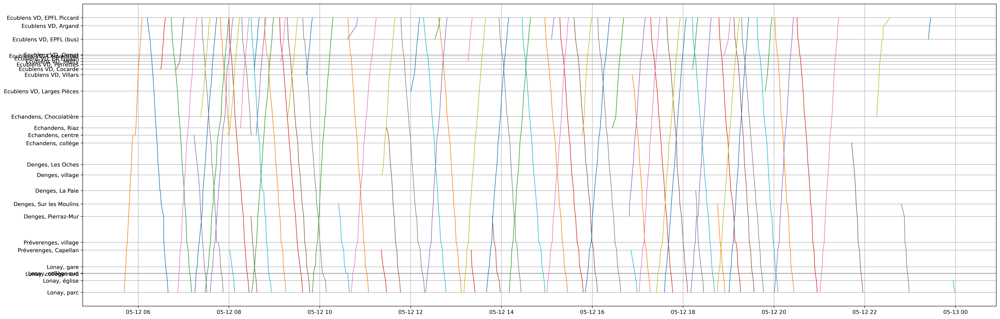

In [129]:
df = lines_data["705"]["real"]

plt.figure(figsize=(30,10), dpi=300)                                                    
for journey in journeys_per_line.get_group(line_id).unique():
    times = df[journey].sort_values()
    distance = df.sort_values(journey)["Distance"]
    plt.plot(times, distance, linewidth=1)
plt.yticks(df.Distance.sort_values(), df.sort_values("Distance").index.get_level_values(0))
plt.grid()
plt.show()
    

### TODO

- time-space diagram for line 705
- Incorporate the geo data [x,y]
- Implement frequency ? Variable speed ?

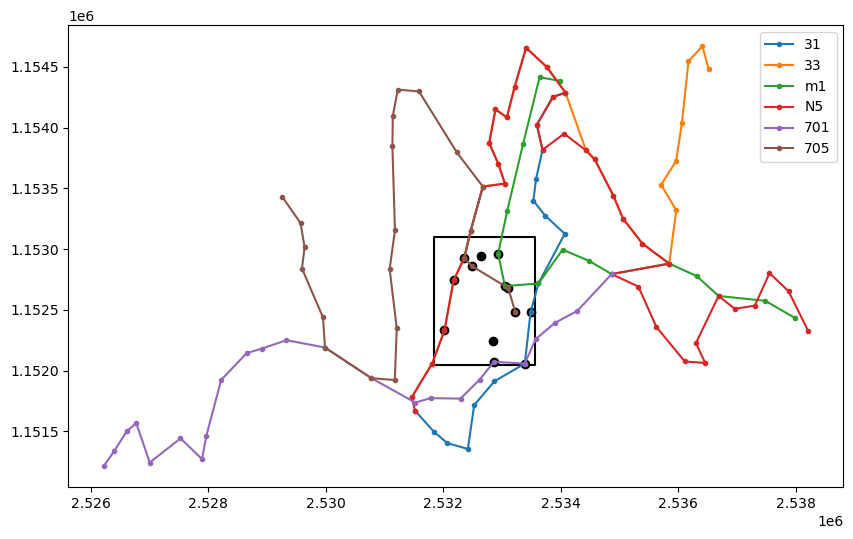

In [88]:
pd.DataFrame.sort_values?

Signature:
pd.DataFrame.sort_values(
    self,
    by: 'IndexLabel',
    *,
    axis: 'Axis' = 0,
    ascending: 'bool | list[bool] | tuple[bool, ...]' = True,
    inplace: 'bool' = False,
    kind: 'SortKind' = 'quicksort',
    na_position: 'str' = 'last',
    ignore_index: 'bool' = False,
    key: 'ValueKeyFunc | None' = None,
) -> 'DataFrame | None'
Docstring:
Sort by the values along either axis.

Parameters
----------
by : str or list of str
    Name or list of names to sort by.

    - if `axis` is 0 or `'index'` then `by` may contain index
      levels and/or column labels.
    - if `axis` is 1 or `'columns'` then `by` may contain column
      levels and/or index labels.
axis : "{0 or 'index', 1 or 'columns'}", default 0
     Axis to be sorted.
ascending : bool or list of bool, default True
     Sort ascending vs. descending. Specify list for multiple sort
     orders.  If this is a list of bools, must match the length of
     the by.
inplace : bool, default False
     If True, p

In [136]:
filtered

,BETRIEBSTAG,FAHRT_BEZEICHNER,BETREIBER_ID,BETREIBER_ABK,BETREIBER_NAME,PRODUKT_ID,LINIEN_ID,LINIEN_TEXT,UMLAUF_ID,VERKEHRSMITTEL_TEXT,...,FAELLT_AUS_TF,BPUIC,HALTESTELLEN_NAME,ANKUNFTSZEIT,AN_PROGNOSE,AN_PROGNOSE_STATUS,ABFAHRTSZEIT,AB_PROGNOSE,AB_PROGNOSE_STATUS,DURCHFAHRT_TF
123506,28.11.2024,85:151:100,85:151,TL,Transports Publics de la Région Lausannoise sa,Bus,85:151:1,1,NaN,B,...,False,8591994,Blécherette,NaN,NaN,NaN,28.11.2024 05:51,28.11.2024 05:51:44,REAL,False
123507,28.11.2024,85:151:100,85:151,TL,Transports Publics de la Région Lausannoise sa,Bus,85:151:1,1,NaN,B,...,False,8591996,Bois-Gentil,28.11.2024 05:52,28.11.2024 05:53:01,REAL,28.11.2024 05:52,28.11.2024 05:53:25,REAL,False
123508,28.11.2024,85:151:100,85:151,TL,Transports Publics de la Région Lausannoise sa,Bus,85:151:1,1,NaN,B,...,False,8592088,Parc Vélodrome,28.11.2024 05:53,28.11.2024 05:54:00,REAL,28.11.2024 05:53,28.11.2024 05:54:00,REAL,False
123509,28.11.2024,85:151:100,85:151,TL,Transports Publics de la Région Lausannoise sa,Bus,85:151:1,1,NaN,B,...,False,8592116,Stade Olympique,28.11.2024 05:54,28.11.2024 05:54:33,REAL,28.11.2024 05:54,28.11.2024 05:54:33,REAL,False
123510,28.11.2024,85:151:100,85:151,TL,Transports Publics de la Région Lausannoise sa,Bus,85:151:1,1,NaN,B,...,False,8592003,Casernes,28.11.2024 05:56,28.11.2024 05:55:36,REAL,28.11.2024 05:56,28.11.2024 05:56:05,REAL,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
554068,28.11.2024,85:764:MBC705-5091_705-A-101_2300_BUSPS124-2,85:764,MBC Auto,Automobiles MBC,Bus,85:764:MBC705,705,NaN,B,...,False,8591951,"Ecublens VD, Motty",28.11.2024 23:21,28.11.2024 23:22:35,REAL,28.11.2024 23:21,28.11.2024 23:22:40,REAL,False
554069,28.11.2024,85:764:MBC705-5091_705-A-101_2300_BUSPS124-2,85:764,MBC Auto,Automobiles MBC,Bus,85:764:MBC705,705,NaN,B,...,False,8591947,"Ecublens VD, Coquerellaz",28.11.2024 23:22,28.11.2024 23:23:20,REAL,28.11.2024 23:22,28.11.2024 23:23:25,REAL,False
554070,28.11.2024,85:764:MBC705-5091_705-A-101_2300_BUSPS124-2,85:764,MBC Auto,Automobiles MBC,Bus,85:764:MBC705,705,NaN,B,...,False,8579233,"Ecublens VD, EPFL (bus)",28.11.2024 23:24,28.11.2024 23:25:21,REAL,28.11.2024 23:24,28.11.2024 23:25:37,REAL,False
554071,28.11.2024,85:764:MBC705-5091_705-A-101_2300_BUSPS124-2,85:764,MBC Auto,Automobiles MBC,Bus,85:764:MBC705,705,NaN,B,...,False,8591944,"Ecublens VD, Argand",28.11.2024 23:25,28.11.2024 23:26:42,REAL,28.11.2024 23:25,28.11.2024 23:26:47,REAL,False


,distance,time
0,0.000000,17.11.2024 15:50:57
1,229.876555,17.11.2024 15:52:08
2,229.876555,17.11.2024 15:52:13
3,867.516736,17.11.2024 15:54:11
4,867.516736,17.11.2024 15:54:16
5,1020.911651,17.11.2024 15:54:54
6,1020.911651,17.11.2024 15:54:59
7,1265.991230,17.11.2024 15:55:18
8,1265.991230,17.11.2024 15:55:23
9,1688.329956,17.11.2024 15:56:14


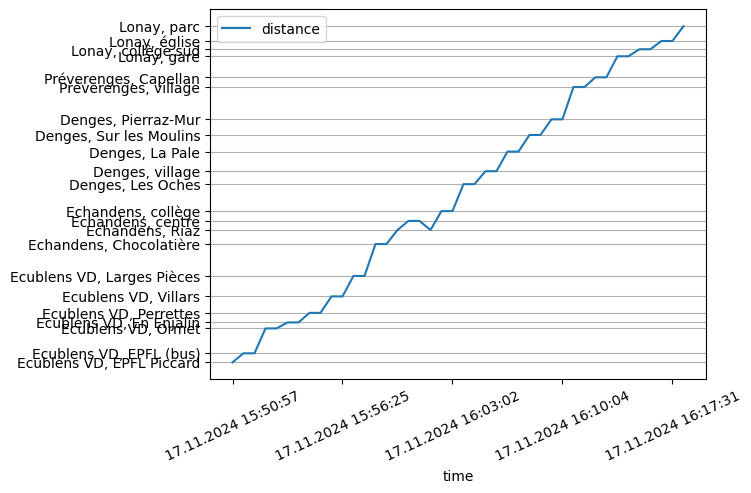

In [94]:
df=line_data["705"].sort_values(by="ArriveeReel", na_position="first")

distance = ((df[["lv95East", "lv95North"]].diff()**2).sum(axis=1)**0.5).cumsum()
df["distance"] = distance
df2 = (df[["distance", "ArriveeReel", "DepartReel"]]
        .copy()
        .set_index("distance")
        .unstack()
        .dropna()
        .droplevel(level=0)
        .sort_values()
        .rename("time")
        .reset_index())
display(df2)
df2.plot(x="time", y="distance")
plt.yticks(distance, df["Name"])
plt.xticks(rotation=25)
plt.grid(axis="y")


In [82]:
filtered["mask"] = filtered.BPUIC.isin(stops_numbers)
group_by = filtered.sort_values(by="AN_PROGNOSE").groupby(["FAHRT_BEZEICHNER"])
stop_i = group_by.cumcount()
mask = group_by["mask"].rolling(3, 1, center=True).max().astype(bool).reset_index(level=0)["mask"]
extended_stops = filtered[mask].BPUIC.unique()

C:\Users\arsju\AppData\Local\Temp\ipykernel_53584\834720406.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered["mask"] = filtered.BPUIC.isin(stops_numbers)
C:\Users\arsju\AppData\Local\Temp\ipykernel_53584\834720406.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  extended_stops = filtered[mask].BPUIC.unique()


In [138]:
Distance.isna()

NameError: name 'Distance' is not defined

C:\Users\arsju\AppData\Local\Temp\ipykernel_53584\3084887974.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  filtered[mask].groupby(["LINIEN_ID", "FAHRT_BEZEICHNER", "BPUIC"]).plot()
c:\Users\arsju\anaconda3\envs\Gurobi\Lib\site-packages\pandas\plotting\_matplotlib\core.py:580: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = self.plt.figure(figsize=self.figsize)


LINIEN_ID      FAHRT_BEZEICHNER                          BPUIC  
85:151:31      85:151:1986                               8501213    Axes(0.125,0.11;0.775x0.77)
                                                         8591944    Axes(0.125,0.11;0.775x0.77)
                                                         8592226    Axes(0.125,0.11;0.775x0.77)
                                                         8592227    Axes(0.125,0.11;0.775x0.77)
               85:151:1987                               8501213    Axes(0.125,0.11;0.775x0.77)
                                                                               ...             
85:764:MBC705  85:764:MBC705-5033_705-A-101_2321_BUS7-2  8579234    Axes(0.125,0.11;0.775x0.77)
                                                         8591944    Axes(0.125,0.11;0.775x0.77)
                                                         8591947    Axes(0.125,0.11;0.775x0.77)
                                                         8591951    Axe

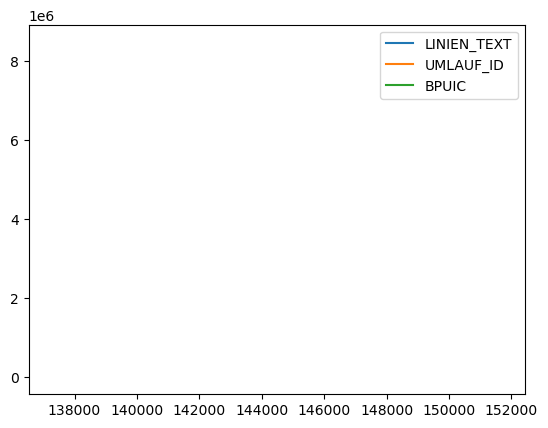

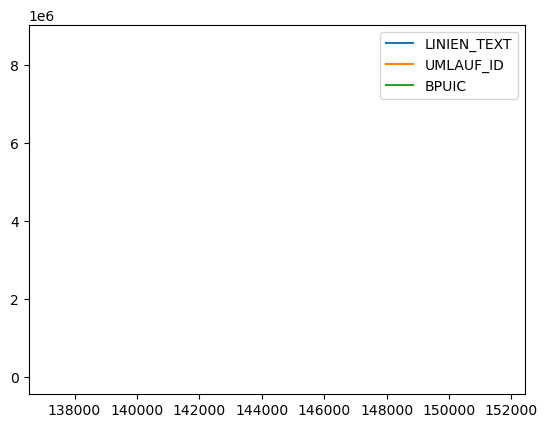

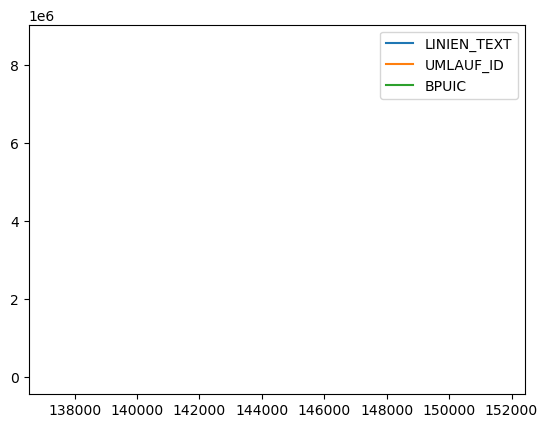

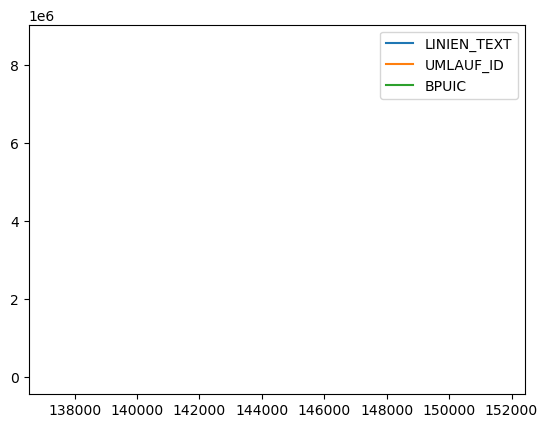

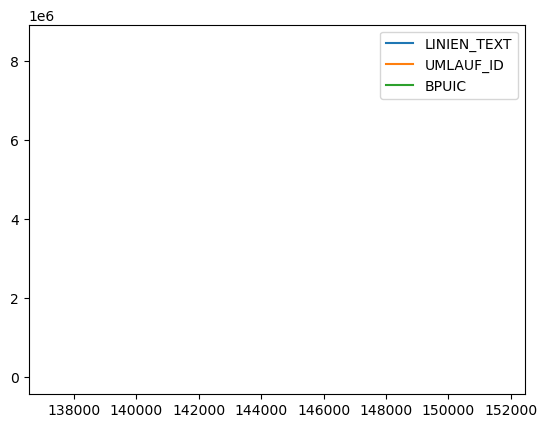

...

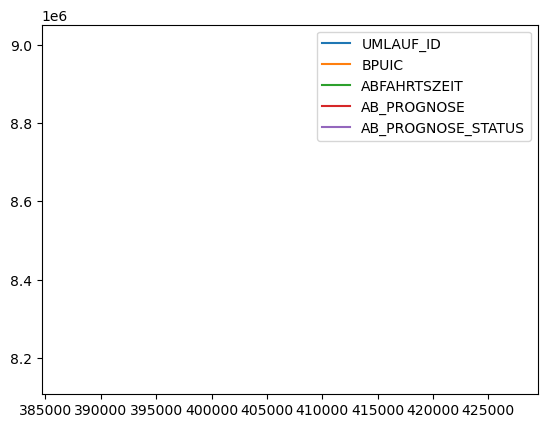

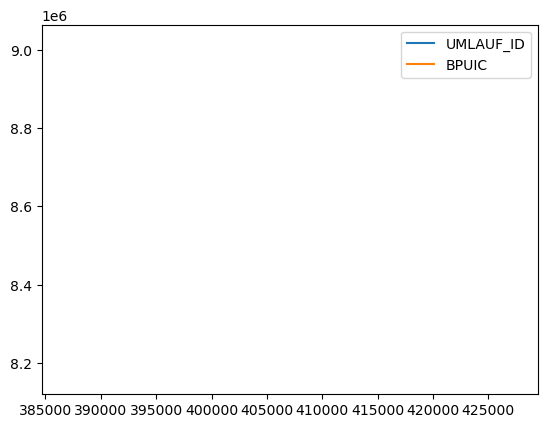

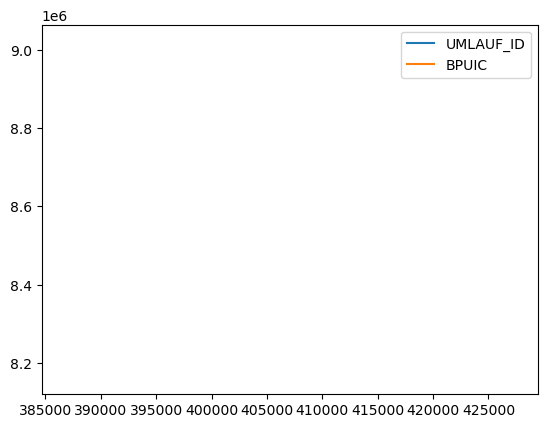

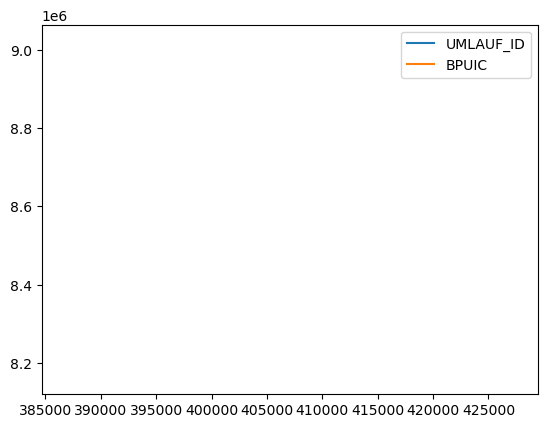

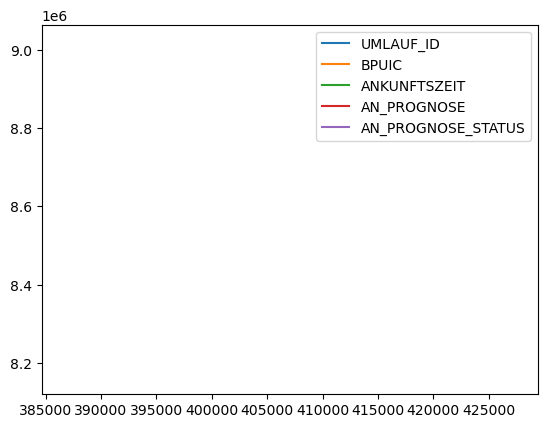

In [88]:
filtered[mask].groupby(["LINIEN_ID", "FAHRT_BEZEICHNER", "BPUIC"]).first()

In [133]:
for journey in journeys_per_line.get_group(line_id).unique():
    print(journey)

85:151:3107
85:151:3108
85:151:3109
85:151:3110
85:151:3111
85:151:3112
85:151:3113
85:151:3114
85:151:3115
85:151:3116
85:151:3117
85:151:3118
85:151:3119
85:151:3120
85:151:3121
85:151:3122
85:151:3123
85:151:3124
85:151:3125
85:151:3126
85:151:3127
85:151:3128
85:151:3129
85:151:3130
85:151:3131
85:151:3132
85:151:3135
85:151:3136
85:151:3137
85:151:3138
85:151:3139
85:151:3140
85:151:3141
85:151:3142
85:151:3143
85:151:3144
85:151:3145
85:151:3146
85:151:3147
85:151:3148
85:151:3149
85:151:3150
85:151:3151
85:151:3152
85:151:3153
85:151:3154
85:151:3155
85:151:3156
85:151:3157
85:151:3158
85:151:3159
85:151:3162
85:151:3163
85:151:3164
85:151:3165
85:151:3166
85:151:3167
85:151:3168
85:151:3169
85:151:3170
85:151:3171
85:151:3172
85:151:3173
85:151:3174
85:151:3175
85:151:3176
85:151:3177
85:151:3178
85:151:3181
85:151:3182
85:151:3183
85:151:3184
85:151:3187
85:151:3188
85:151:3189
85:151:3190
85:151:3191
85:151:3192
85:151:3193
85:151:3194
85:151:3195
85:151:3196
85:151:3197
85:1

In [134]:
plt.plot?

Signature:
plt.plot(
    *args: 'float | ArrayLike | str',
    scalex: 'bool' = True,
    scaley: 'bool' = True,
    data=None,
    **kwargs,
) -> 'list[Line2D]'
Docstring:
Plot y versus x as lines and/or markers.

Call signatures::

    plot([x], y, [fmt], *, data=None, **kwargs)
    plot([x], y, [fmt], [x2], y2, [fmt2], ..., **kwargs)

The coordinates of the points or line nodes are given by *x*, *y*.

The optional parameter *fmt* is a convenient way for defining basic
formatting like color, marker and linestyle. It's a shortcut string
notation described in the *Notes* section below.

>>> plot(x, y)        # plot x and y using default line style and color
>>> plot(x, y, 'bo')  # plot x and y using blue circle markers
>>> plot(y)           # plot y using x as index array 0..N-1
>>> plot(y, 'r+')     # ditto, but with red plusses

You can use `.Line2D` properties as keyword arguments for more
control on the appearance. Line properties and *fmt* can be mixed.
The following two calls yie